In [1]:

>>> from sklearn.random_projection import johnson_lindenstrauss_min_dim 
>>> m, ε = 5_000, 0.1
>>> d = johnson_lindenstrauss_min_dim(m, eps=ε)
>>> d



7300

In [2]:
import numpy as np
n = 20_000
np.random.seed(42)
P = np.random.randn(d, n) / np.sqrt(d) # std dev = square root of variance
X = np.random.randn(m, n) # generate a fake dataset X_reduced = X @ P.T

In [3]:
X_reduced = X @ P.T

In [4]:
X_reduced

array([[ 0.65601016, -1.52157349, -2.13016582, ..., -3.30298058,
         1.86509223, -0.62205374],
       [-1.15983875, -1.31973727,  0.13553982, ..., -0.9461484 ,
        -0.01875402,  1.15834454],
       [-2.79258363,  0.47631317, -3.2293912 , ...,  1.41899815,
         3.03817514, -2.07598188],
       ...,
       [ 0.18867284,  0.58379053,  1.42444552, ...,  0.13507484,
         1.83874287, -0.39265772],
       [ 2.54718434,  0.32063561, -3.59830134, ...,  0.49247486,
         0.46798188,  0.09910125],
       [ 3.68422382, -2.65487692,  0.55763148, ...,  2.14734207,
        -1.82840766,  0.76915154]])

In [5]:
from sklearn.random_projection import GaussianRandomProjection 
gaussian_rnd_proj = GaussianRandomProjection(eps=ε, random_state=42)
X_reduced = gaussian_rnd_proj.fit_transform(X) # same result as above

In [6]:
X_reduced.shape

(5000, 7300)

In [7]:
np.random.randn(d, n) * np.sqrt(1/d)

array([[-0.0054598 , -0.01674431, -0.00088403, ..., -0.02009506,
        -0.0015797 , -0.02479177],
       [-0.00693031,  0.0161869 ,  0.02001335, ...,  0.00362369,
         0.00467808,  0.00484302],
       [ 0.01156952,  0.00670102, -0.00231684, ..., -0.01234184,
         0.01036478, -0.00493619],
       ...,
       [-0.01848613,  0.00593019, -0.00193075, ..., -0.00393743,
         0.00499719, -0.00535861],
       [-0.01395154, -0.01182964, -0.0181788 , ...,  0.01091433,
         0.00050124, -0.00423578],
       [-0.0004892 ,  0.0040597 , -0.01319266, ...,  0.00793583,
         0.00369743, -0.00309658]])

In [ ]:
components_pinv = np.linalg.pinv(gaussian_rnd_proj.components_)
X_recovered = X_reduced @ components_pinv.T


In [ ]:
components_pinv.c

In [ ]:
from sklearn.datasets import fetch_openml
mnist = fetch_openml('mnist_784', as_frame=False)
X_train, y_train = mnist.data[:60_000], mnist.target[:60_000]
X_test, y_test = mnist.data[60_000:], mnist.target[60_000:]

In [ ]:
from sklearn.decomposition import IncrementalPCA
n_batch =100
inpca = IncrementalPCA(n_components=154)
for x_batch in np.array_split(X_train,n_batch):
    inpca.partial_fit(x_batch)

inpca.transform(X_train)

In [ ]:
from numpy import memmap

In [ ]:
mapmem = 'binary.memmap'
X_memmap = memmap(mapmem,dtype='float32',mode='write',shape=X_train.shape)
X_memmap[:] = X_train
X_memmap.flush()

In [ ]:
X_memmap1 = memmap(mapmem,dtype='float32',mode='readonly').reshape(-1,784)
batches = len(X_train)//n_batch
inpca1 = IncrementalPCA(n_components=154,batch_size=batches)
inpca1.fit_transform(X_memmap1)

In [ ]:
from sklearn.random_projection import johnson_lindenstrauss_min_dim
d = johnson_lindenstrauss_min_dim(n_samples=5000,eps=0.1)

In [ ]:
np.random.seed(42)
n =20000
m=5000
P = np.random.randn(d,n)/np.sqrt(d)
X_new = np.random.randn(m,n)

In [ ]:
X_new@P.T

In [ ]:
from sklearn.random_projection import GaussianRandomProjection
gau = GaussianRandomProjection(eps=0.1,random_state=42)
X_reduced = gau.fit_transform(X_new)

In [ ]:
components_pinv = np.linalg.pinv(gau.components_)
X_recovered = X_reduced @ components_pinv.T

In [ ]:
X_recovered

In [ ]:
gau.components_

# Exercises

In [1]:
from sklearn.ensemble import RandomForestClassifier
import timeit
import numpy as np
import warnings
warnings.filterwarnings('ignore')
# from sklearn.decomposition import PCA
# from sklearn.model_selection import cross_val_predict,cross_val_score

In [2]:
from sklearn.datasets import fetch_openml
mnist = fetch_openml('mnist_784', as_frame=False)

In [3]:
X,y = mnist.data,mnist.target
X_train,y_train,X_test,y_test = X[:60000],y[:60000],X[60000:],y[60000:]

In [4]:
import timeit
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import fetch_openml
mnist = fetch_openml('mnist_784', as_frame=False)

X,y = mnist.data,mnist.target
X_train,y_train,X_test,y_test = X[:60000],y[:60000],X[60000:],y[60000:]

def randomforest():
    rnd_clf = RandomForestClassifier()
    rnd_clf.fit(X_train,y_train)
    return rnd_clf

elapsed_time =  timeit.timeit(randomforest,number=1)
print(elapsed_time)
rnd_clf = randomforest()
rnd_clf.score(X_test,y_test)


47.45784856499995


0.9699

In [5]:
from sklearn.decomposition import PCA
pca = PCA(n_components=0.95)
X_reduced = pca.fit_transform(X)
X_trainpca,X_testpca = X_reduced[:60000],X_reduced[60000:]

In [6]:
def pcarandomforest():
    rnd_clf1 = RandomForestClassifier()  
    rnd_clf1.fit(X_trainpca,y_train)
    return rnd_clf1

elapsed_time =  timeit.timeit(pcarandomforest,number=1)
print(elapsed_time)

rnd_clf1 = pcarandomforest()
rnd_clf1.score(X_testpca,y_test)

124.80896248999989


0.9491

In [7]:
from sklearn.linear_model import SGDClassifier
def sgdclass():
    sgd_clf = SGDClassifier()
    sgd_clf.fit(X_train,y_train)
    return rnd_clf

elapsed_time =  timeit.timeit(sgdclass,number=1)
print(elapsed_time)
sgd_clf = sgdclass()
sgd_clf.score(X_test,y_test)

172.94149582


0.9699

In [8]:
def pcasgdclass():
    sgd_clf1 = SGDClassifier()  
    sgd_clf1.fit(X_trainpca,y_train)
    return rnd_clf1

elapsed_time =  timeit.timeit(pcasgdclass,number=1)
print(elapsed_time)

sgd_clf1 = pcasgdclass()
sgd_clf1.score(X_testpca,y_test)

27.7931991129999


0.9491

In [9]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, init="random", learning_rate="auto",
            random_state=42)
X_reduced_tsne = tsne.fit_transform(X_train[:5000])

In [10]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10,random_state=42)
X_kmeans = kmeans.fit_transform(X_reduced_tsne)


In [11]:
len(np.max(X_kmeans,axis=1))

5000

In [12]:
y_int = y_train.astype('int64')

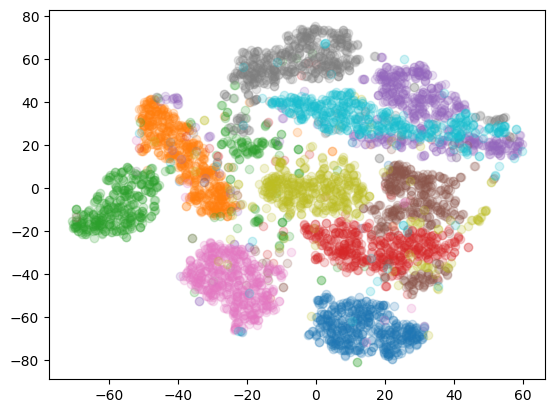

In [13]:
# fig,ax = plt.figure()
import matplotlib.pyplot as plt
colors = plt.cm.tab10(range(10))
category_colors = {'0': colors[0], '1': colors[1], '2': colors[2],'3':colors[3],'4':colors[4],'5':colors[5],
                   '6':colors[6],'7':colors[7],'8':colors[8],'9':colors[9]}


for category in rnd_clf.classes_:
    mask = y_train[:5000] == category
    plt.scatter(X_reduced_tsne[:,0][mask], X_reduced_tsne[:,1][mask],c=category_colors[category].tolist(),
                label=category,alpha=0.2)

plt.show()

In [14]:
import matplotlib.pyplot as plt

In [15]:
for i in range(5000):
    plt.text(X_reduced_tsne[i,0], X_reduced_tsne[i,1], y_train[i])
plt.show()

In [16]:
# plt.text?

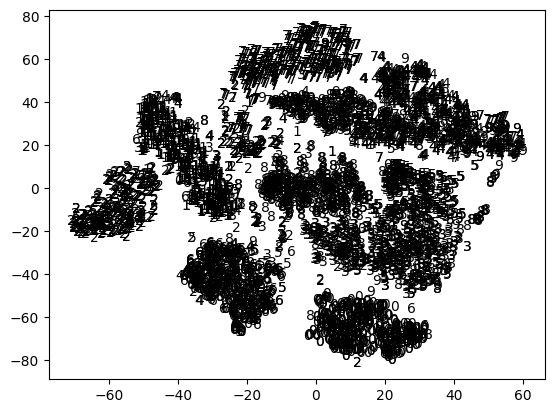

In [17]:
plt.scatter(X_reduced_tsne[:,0], X_reduced_tsne[:,1],alpha=0)

# Add number annotations at each data point
for i in range(len(y_train[:5000])):
    plt.text(X_reduced_tsne[i,0], X_reduced_tsne[i,1], y_train[i], ha='center', va='center')
plt.show()

In [18]:
X_reduced_tsne[:5]

array([[ 27.29423  , -12.066925 ],
       [  8.205369 , -66.170876 ],
       [ 53.31725  ,  15.1813965],
       [-43.657703 ,  33.87111  ],
       [ 17.937662 ,  27.119612 ]], dtype=float32)

In [19]:
# X_reduX_reduced_tsne[y_train[:5000] == '2']

In [20]:
import numpy as np
import pandas as pd

In [21]:
df = pd.DataFrame([X_reduced_tsne[:,0],X_reduced_tsne[:,1],y_train[:5000]])
df = df.T
df.sort_values(by=[2,0],inplace=True)

In [22]:
df

,0,1,2
1512,-39.807983,3.313317,0
1916,-21.985458,-66.721382,0
2352,-21.770344,-66.715179,0
2765,-21.46562,-67.130836,0
1423,-2.321071,-68.624229,0
...,...,...,...
3346,54.855751,28.696447,9
1518,57.308243,14.220191,9
2934,58.048668,27.588774,9
2798,58.090576,27.49688,9


In [23]:
tsne.n_components

2

In [24]:
X_reduced_tsne1 = np.c_[df[0],df[1]]

In [25]:
y_train_tsne1 = np.array(df[2])

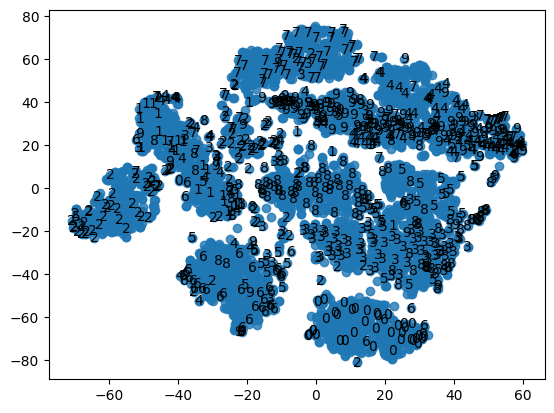

In [26]:
previous_x = 0
plt.scatter(X_reduced_tsne1[:,0], X_reduced_tsne1[:,1],alpha=0.8)
for i in range(5000):
    if (X_reduced_tsne1[i,0] - previous_x )**2 >0.028:
        plt.text(X_reduced_tsne1[i,0], X_reduced_tsne1[i,1], y_train_tsne1[i], ha='center', va='center')
    previous_x = X_reduced_tsne1[i,0]
plt.show()

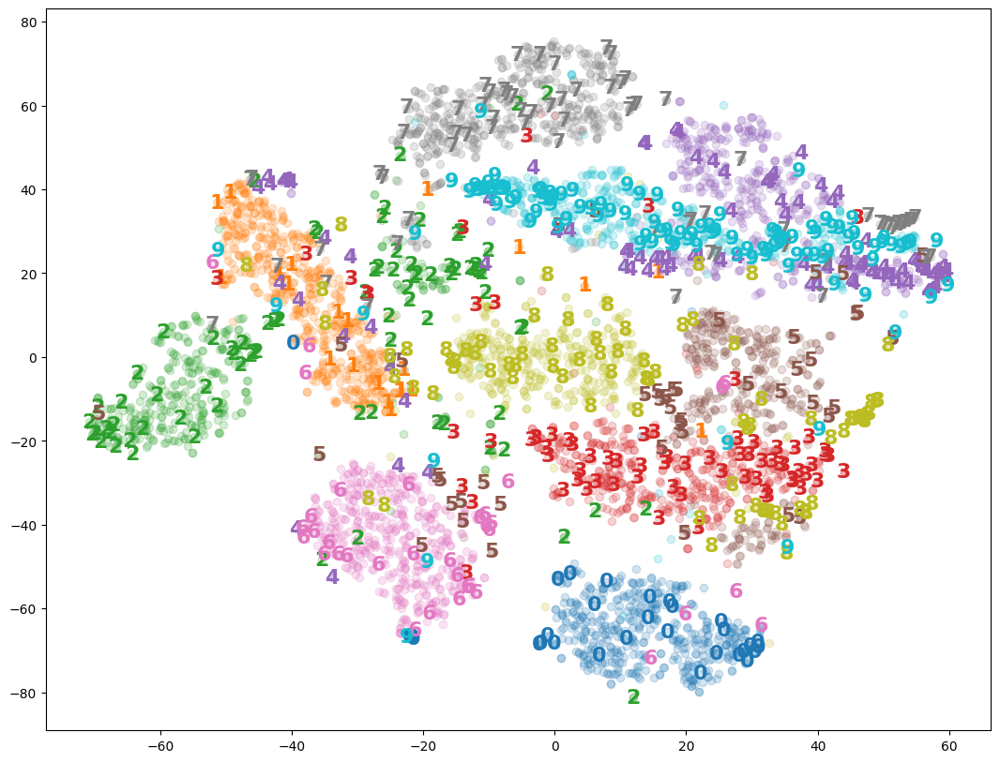

In [27]:
import matplotlib.pyplot as plt
colors = plt.cm.tab10(range(10))
category_colors = {'0': colors[0], '1': colors[1], '2': colors[2],'3':colors[3],'4':colors[4],'5':colors[5],
                   '6':colors[6],'7':colors[7],'8':colors[8],'9':colors[9]}

plt.figure(figsize=(13, 10))
for category in rnd_clf.classes_:
    mask = y_train_tsne1[:5000] == category
    plt.scatter(X_reduced_tsne1[:,0][mask], X_reduced_tsne1[:,1][mask],c=category_colors[category].tolist(),
                label=category,alpha=0.2)
    
for i in range(5000):
    if (X_reduced_tsne1[i,0] - previous_x )**2 >0.04:
        plt.text(X_reduced_tsne1[i,0], X_reduced_tsne1[i,1], y_train_tsne1[i], ha='center', va='center',
                c=category_colors[y_train_tsne1[i]],fontdict={"weight": "bold", "size": 16})
    previous_x = X_reduced_tsne1[i,0]
plt.show()

In [28]:
# plt.text?

In [29]:
# X_reduced_tsne=='0']

In [30]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
def images(x):
    ims = x.reshape(28,28)
    return ims



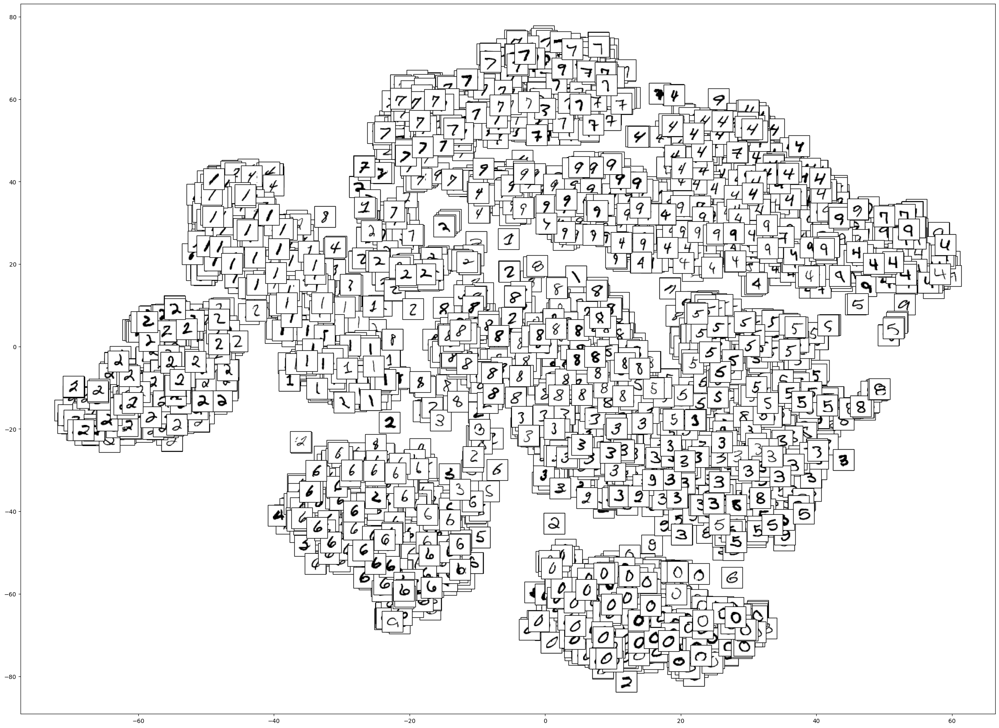

In [38]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(30, 22))
colors = plt.cm.tab10(range(10))
category_colors = {'0': colors[0], '1': colors[1], '2': colors[2],'3':colors[3],'4':colors[4],'5':colors[5],
                   '6':colors[6],'7':colors[7],'8':colors[8],'9':colors[9]}

# plt.figure(figsize=(30, 22))
for category in rnd_clf.classes_:
    mask = y_train[:5000] == category
    plt.scatter(X_reduced_tsne[:,0][mask], X_reduced_tsne[:,1][mask],c=category_colors[category].tolist(),
                label=category,alpha=0.2)
previous_x = 0    
for i in range(5000):
        imagebox = OffsetImage(images(X_train[:5000][i]),cmap='binary')
#     if (X_reuced_tsne1[i,0] - previous_x )**2 >0.02:
        annotation = AnnotationBbox(imagebox, (X_reduced_tsne[i,0],X_reduced_tsne[i,1]), frameon=True)
        ax.add_artist(annotation)
        previous_x = X_reduced_tsne[i,0]
plt.show()